# Content

## 1.Introduction to Stock Price Performance Analysis

1a. How does a stock perform over the a certain period of time?

1b. Advance Visualisation of the Stock Performance 

- Moving Averages 
- Candlesticks 


## 2. Diversification

2a. Why is diviersification important?

2b. What does a fund manager (portfolio manager) do?

## 3. Hypothesis

Null Hypothesis: Do technology stocks (FAANG) outperform than S&P 500 in the last two years?

## 4. Conclusion

# 1.Introduction to Stock Price Performance Analysis

In order to perform individual stock price analysis, one can extract the relevant price information from [here](https://www.alphavantage.co/documentation/)

Additional documentation for the usage of pandas_datareader [click here](https://buildmedia.readthedocs.org/media/pdf/pandas-datareader/latest/pandas-datareader.pdf)

In [1]:
# Import the relevant libraries

import pandas as pd
import numpy as np
import matplotlib.dates as mdates
import matplotlib.pyplot as plt

import seaborn as sns
sns.set_style('whitegrid')  # Give nice white background with grid
%matplotlib inline
import plotly.express as px

pd.set_option("display.max_rows", 1000)
pd.set_option("display.max_columns", 100)

from datetime import datetime

from matplotlib.offsetbox import AnchoredText


# Additionally, these two modules are imported in order to extract the information from the above website by using the API
import os
import pandas_datareader.data as web

As the goal of this analysis is to perform a null hypothesis in FAANG stocks, a list of the relevant company names and their corresponding ticker symbols are created.

For more information in FAANG please click [here](https://www.investopedia.com/terms/f/faang-stocks.asp).

In [2]:
# Provide FAANG stock ticker symbols and their corresponding names 

tech_list = ["FB","AMZN","AAPL","NFLX","GOOGL"]

tech_name = ["Facebook","Amazon", "Apple", "Netflix", "Google"]

In [3]:
# import your API code

import getpass

password = getpass.getpass()

········


In [4]:
# Enter the desired date range. A two year timeframe are selected for this project

end = datetime(2019, 11, 20)

start = datetime(end.year-2,end.month,end.day)

In [5]:
# Create 5 DataFrames for the FAANG

for stock in tech_list:
    globals()[stock] = web.DataReader(stock, "av-daily-adjusted", start=start,end=end,api_key=password)


In [6]:
FB

,open,high,low,close,adjusted close,volume,dividend amount,split coefficient
2017-11-20,178.8700,179.5000,178.1000,178.740,178.740,10052391,0.0,1.0
2017-11-21,179.1500,181.8900,178.9900,181.860,181.860,14409305,0.0,1.0
2017-11-22,181.3000,181.7300,180.4400,180.870,180.870,10238140,0.0,1.0
2017-11-24,180.4000,183.1500,180.2900,182.780,182.780,9426010,0.0,1.0
2017-11-27,182.5600,183.7300,181.9900,183.030,183.030,12249740,0.0,1.0
2017-11-28,183.5100,184.2500,182.0900,182.420,182.420,13761926,0.0,1.0
2017-11-29,181.8900,181.9700,174.0000,175.130,175.130,41843917,0.0,1.0
2017-11-30,176.8500,178.2750,175.2000,177.180,177.180,25127073,0.0,1.0
2017-12-01,176.0300,177.4800,172.3400,175.100,175.100,19966643,0.0,1.0
2017-12-04,176.2900,176.5700,170.7900,171.470,171.470,24184006,0.0,1.0


## 1a. How does a stock perform over the a certain period of time?

Facebook is used to perform individual stock price analysis

In [7]:
FB.dtypes

open                 float64
high                 float64
low                  float64
close                float64
adjusted close       float64
volume                 int64
dividend amount      float64
split coefficient    float64
dtype: object

In [8]:
# Create a list to store all dataframe into a single list

tech_df = [FB,AMZN,AAPL,NFLX,GOOGL]

In [9]:
FB = FB.reset_index().rename(columns={"index":"date"})

#Convert object to datetime format
FB["date"] = pd.to_datetime(FB["date"])

In [10]:
# These codes are used in order to set xticks in the plt graph into individual months 

years = mdates.YearLocator()   # every year
months = mdates.MonthLocator()  # every month
years_fmt = mdates.DateFormatter('%Y')

C:\Users\Kaspar\AppData\Roaming\Python\Python37\site-packages\pandas\plotting\_matplotlib\converter.py:103: FutureWarning:

Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()



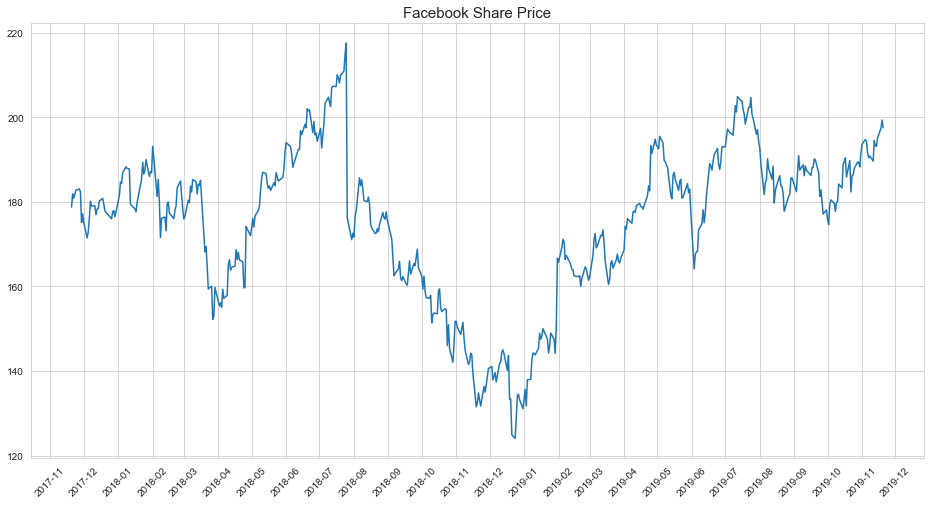

In [11]:
# Simple price performance over the destined period with plt
fig, ax = plt.subplots(figsize=(16,8))

ax.plot("date","adjusted close",data=FB);

ax.xaxis.set_major_locator(months);
plt.xticks(rotation=45);
plt.title("Facebook Share Price", fontsize=15);

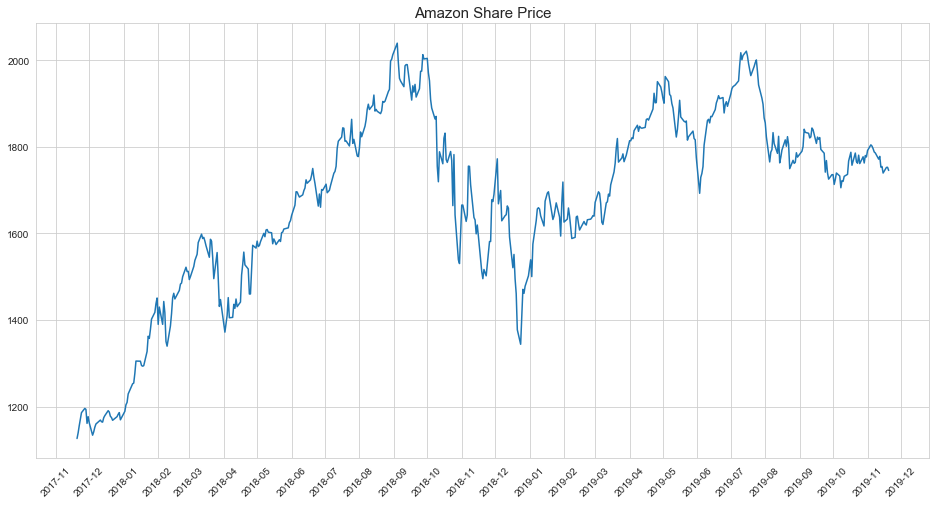

In [12]:
# Simple price performance over the destined period with plt
test = AMZN.copy()

test = test.reset_index().rename(columns={"index":"date"})

#Convert object to datetime format
test["date"] = pd.to_datetime(test["date"])

fig, ax = plt.subplots(figsize=(16,8))

ax.plot("date","adjusted close",data=test);

ax.xaxis.set_major_locator(months);
plt.xticks(rotation=45);
plt.title("Amazon Share Price", fontsize=15);

As seen from the above graph, while the price pattern could give a general view of the stock's performance over the last two years, it does not provide further trends on the price and its daily volatility. 

Hence, most investors opt to use additional indicators while performing technical analysis to support their decision before investing into the stock.

Note that there are 3 main types of analysis when analysing stocks, they are:

- [Fundamental Analysis](https://www.investopedia.com/terms/f/fundamentalanalysis.asp). Traders examine the financial and economic factors in order to forecast the underlying price.  
- [Technical Analysis](https://www.investopedia.com/terms/t/technicalanalysis.asp). Traders analyse statistical trends gathered from trading activity, such as price movement and volume.
- [Sentimental Analysis](https://www.investopedia.com/terms/m/marketsentiment.asp). Sentimental analysis is the feeling or tone of a market, or its crowd psychology, as revealed through the activity and price movement of the securities traded in that market. 

For the sake of simplicity to visualise the trading strategy, technical analysis is solely in this notebook.

## 1b. Advance Visualisation of the Stock Performance 

### Moving Averages

Moving averages acts as an indicator in technical analysis that helps smooth out price action by filtering out the “noise” from random short-term price fluctuations.

For instance, a 10 day moving average (10-Day SMA) calculate the mean of the 


There are other types of moving averages that gained populance in technical analysis. In general, there are 4 main types of MAs:

- Simple Moving Average (SMA)
- Exponential Moving Average (EMA)
- Weighted Moving Average (WMA)
- Moving Average Convergence Divergence (MACD)

For more information please read [here](https://www.investopedia.com/terms/m/movingaverage.asp)

[MACD](https://www.investopedia.com/terms/m/macd.asp) is particularly used by traders to spot trading opportunities.


In [13]:
# Add simple moving average (SMA) to FB

ma_day = [10,20,50]

for ma in ma_day:
    column_name = f"MA for {ma} days"
    
    FB[column_name] = FB['adjusted close'].rolling(ma).mean()

In [14]:
FB

,date,open,high,low,close,adjusted close,volume,dividend amount,split coefficient,MA for 10 days,MA for 20 days,MA for 50 days
0,2017-11-20,178.8700,179.5000,178.1000,178.740,178.740,10052391,0.0,1.0,NaN,NaN,NaN
1,2017-11-21,179.1500,181.8900,178.9900,181.860,181.860,14409305,0.0,1.0,NaN,NaN,NaN
2,2017-11-22,181.3000,181.7300,180.4400,180.870,180.870,10238140,0.0,1.0,NaN,NaN,NaN
3,2017-11-24,180.4000,183.1500,180.2900,182.780,182.780,9426010,0.0,1.0,NaN,NaN,NaN
4,2017-11-27,182.5600,183.7300,181.9900,183.030,183.030,12249740,0.0,1.0,NaN,NaN,NaN
5,2017-11-28,183.5100,184.2500,182.0900,182.420,182.420,13761926,0.0,1.0,NaN,NaN,NaN
6,2017-11-29,181.8900,181.9700,174.0000,175.130,175.130,41843917,0.0,1.0,NaN,NaN,NaN
7,2017-11-30,176.8500,178.2750,175.2000,177.180,177.180,25127073,0.0,1.0,NaN,NaN,NaN
8,2017-12-01,176.0300,177.4800,172.3400,175.100,175.100,19966643,0.0,1.0,NaN,NaN,NaN
9,2017-12-04,176.2900,176.5700,170.7900,171.470,171.470,24184006,0.0,1.0,178.8580,NaN,NaN


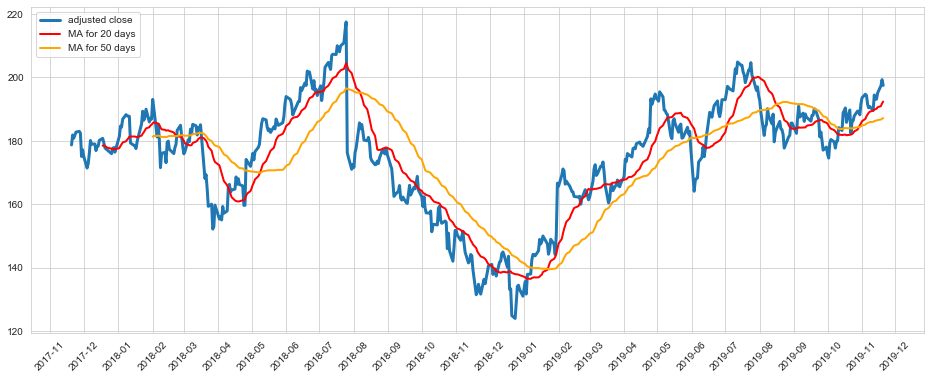

In [15]:
## Plot adjusted close and MAs
fig, ax = plt.subplots(figsize=(16,6))

ax.plot("date","adjusted close",data=FB,linewidth=3);
#ax.plot("date","MA for 10 days",data=FB,linewidth=2);
ax.plot("date","MA for 20 days",data=FB,linewidth=2, color="red");
ax.plot("date","MA for 50 days",data=FB,linewidth=2, color="orange");


ax.xaxis.set_major_locator(months);
plt.xticks(rotation=45);
plt.legend(loc="upper left");


## Candlestick graph

Candlesticks show that emotion by visually representing the size of price moves with different colors. Traders use the candlesticks to make trading decisions based on regularly occurring patterns that help forecast the short-term direction of the price.

For more information, please check [here](https://www.investopedia.com/trading/candlestick-charting-what-is-it/)

In order to create an interactive graph with the embedment of both candlesticks and moving averages in the original graph, __plotly express__ is used.


In [16]:
# Use candlestick graph instead for better visualisation  
import plotly.express as px
import plotly.graph_objects as go

fig = go.Figure()
# Plot the candlestick graph and the other trendlines (MAs)
fig.add_trace(go.Candlestick(x=FB["date"],
                open=FB["open"], high=FB["high"],
                low=FB["low"], close=FB["close"],name="Adjusted Price"))
fig.add_trace(go.Scatter(x=FB["date"], y=FB["adjusted close"],name="price",line = dict(width = 1, color="lightblue"),mode="lines"))
fig.add_trace(go.Scatter(x=FB["date"], y=FB["MA for 20 days"], name="MA for 20 days",line = dict(color='royalblue',width = 1.5),mode="lines"))
fig.add_trace(go.Scatter(x=FB["date"], y=FB["MA for 50 days"],name="MA for 50 days",line = dict(color='burlywood',width = 1.5),mode="lines"))

# Manually enlarging the graph and adding title for the graph
fig.update_layout(autosize= False, width =1000, height=500,title=f"{tech_name[0]} Candlestick Graph from {FB['date'].iloc[0].strftime('%b %Y')} to {FB['date'].iloc[-1].strftime('%b %Y')} ", showlegend=True) 

# Add monthly ticks in x-axis
fig.layout.xaxis.tickvals = pd.date_range(FB["date"].iloc[0], FB["date"].iloc[-1], freq='MS')
fig.layout.xaxis.tickformat = '%b %y'

# Not showing rangeslider
fig.layout.xaxis.rangeslider.visible=False

#Rotate the x-axis and change the fontsize of the x-axis 
fig.update_xaxes(tickangle=-45, tickfont=dict(size=10))

fig.show()

## Conclusion:
### Trading Strategy with the use of MAs
As a general simplistic trading rule of thumb, it is considered by traders to be a good opportunity to __short sell__ the underlying when the market is bearish (downtrend graph) and when the shorter MA (20 days MA in the above graph) crosses below the longer MA (50 days in the above graph). (E.g. early August 2018) 

In contrast, a great to __buy__ the underlying is when the market is bullish (uptrend graph) and when the shorter MA (20 days MA in the above graph) crosses above the longer MA (50 days in the above graph).





# 2. Diversification

## 2a. Why is diversification important?

### Caveat of the MA trading strategy
It is very noticeable that the share price dropped significantly (over 20%) in late July [background news](https://www.marketwatch.com/story/facebook-stock-crushed-after-revenue-user-growth-miss-2018-07-25)

If an investor would have simply followed the MA trading strategy and invested in early May, he/she would have incurred a huge loss in late July. While there are a lot of other ways to prevent this including setting a __target profit__ and placing a __stop loss order__, investors could potentially still lose significant portion of their investments if these are not executed properly.

Therefore, a __diversifcation strategy__ in stock investment is generally encouraged and used by all portfolio managers.

## 2b. What does a fund manager (portfolio manager) do?

A portfolio manager is a person or group of people responsible for investing a mutual, exchange-traded or closed-end fund's assets, implementing its investment strategy and managing day-to-day portfolio trading. [Infos](https://www.investopedia.com/terms/p/portfoliomanager.asp)


Their tasks include:

- _1. Stock Correlation Analysis_
- _2. Price Forecasting_
- _3. Risk Analysis_
- _4. Portfolio Management_ (Ultimately this is their daily task, which is to monitor the portfolio's performance)




In [17]:
# Group all the adjusted price of the FAANG stocks together for further analysis

FAANG_portfolio=FB[["date","adjusted close"]].copy()
FAANG_portfolio = FAANG_portfolio.rename(columns={"adjusted close": f"{tech_name[0]}"})

In [18]:
FAANG_portfolio

,date,Facebook
0,2017-11-20,178.740
1,2017-11-21,181.860
2,2017-11-22,180.870
3,2017-11-24,182.780
4,2017-11-27,183.030
5,2017-11-28,182.420
6,2017-11-29,175.130
7,2017-11-30,177.180
8,2017-12-01,175.100
9,2017-12-04,171.470


In [19]:
for i in range(len(tech_df)):
    # as the first company is Facebook and its adjust price is already in FAANG, it is ignored in the following codes
    if i ==0:  #tech_df[0] returns Facebook DataFrame
        continue
    else:
        stock_df=tech_df[i].copy()
    
        #reset index and change the type of date
        stock_df = stock_df.reset_index().rename(columns={"index":"date"})
        stock_df["date"] = pd.to_datetime(stock_df["date"])

        #merge the selected column together
        FAANG_portfolio = FAANG_portfolio.merge(stock_df[["date", "adjusted close"]], how="left", on="date")
        FAANG_portfolio = FAANG_portfolio.rename(columns={"adjusted close": f"{tech_name[i]}"})
    
    
FAANG_portfolio



,date,Facebook,Amazon,Apple,Netflix,Google
0,2017-11-20,178.740,1126.31,164.9812,194.100,1034.66
1,2017-11-21,181.860,1139.49,168.0483,196.230,1050.30
2,2017-11-22,180.870,1156.16,169.8147,196.320,1051.92
3,2017-11-24,182.780,1186.00,169.8245,195.750,1056.52
4,2017-11-27,183.030,1195.83,168.9703,195.050,1072.01
5,2017-11-28,182.420,1193.60,167.9803,199.180,1063.29
6,2017-11-29,175.130,1161.27,164.4959,188.150,1037.38
7,2017-11-30,177.180,1176.75,166.7962,187.580,1036.17
8,2017-12-01,175.100,1162.35,166.0197,186.820,1025.07
9,2017-12-04,171.470,1133.95,164.8065,184.040,1011.87


### 2b. 1) Stock Correlation Analysis

#### Several types of correlation graphs between the stock pairs can be plotted

In [20]:
# Create a copy of the portfolio
FAANG_portfolio_analysis = FAANG_portfolio.copy()

In [21]:
# Set date as the index for the analysis

FAANG_portfolio_analysis = FAANG_portfolio_analysis.set_index("date")

In [22]:
# Calculate the percentage change of the daily adjusted closing price (daily return)

FAANG_portfolio_analysis_pct = FAANG_portfolio_analysis.pct_change()

In [23]:
FAANG_portfolio_analysis_pct

,Facebook,Amazon,Apple,Netflix,Google
date,,,,,
2017-11-20,NaN,NaN,NaN,NaN,NaN
2017-11-21,0.017456,0.011702,0.018591,0.010974,0.015116
2017-11-22,-0.005444,0.014629,0.010511,0.000459,0.001542
2017-11-24,0.010560,0.025810,0.000058,-0.002903,0.004373
2017-11-27,0.001368,0.008288,-0.005030,-0.003576,0.014661
2017-11-28,-0.003333,-0.001865,-0.005859,0.021174,-0.008134
2017-11-29,-0.039963,-0.027086,-0.020743,-0.055377,-0.024368
2017-11-30,0.011706,0.013330,0.013984,-0.003029,-0.001166
2017-12-01,-0.011739,-0.012237,-0.004655,-0.004052,-0.010713


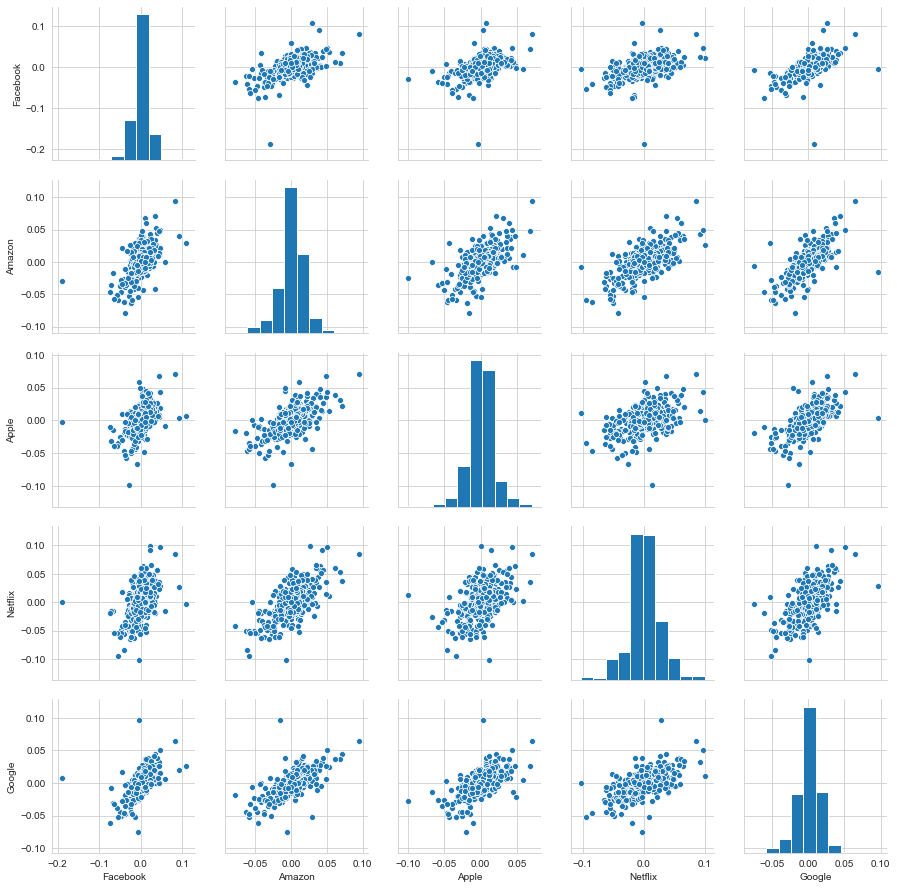

In [24]:
sns.pairplot(FAANG_portfolio_analysis_pct.dropna());

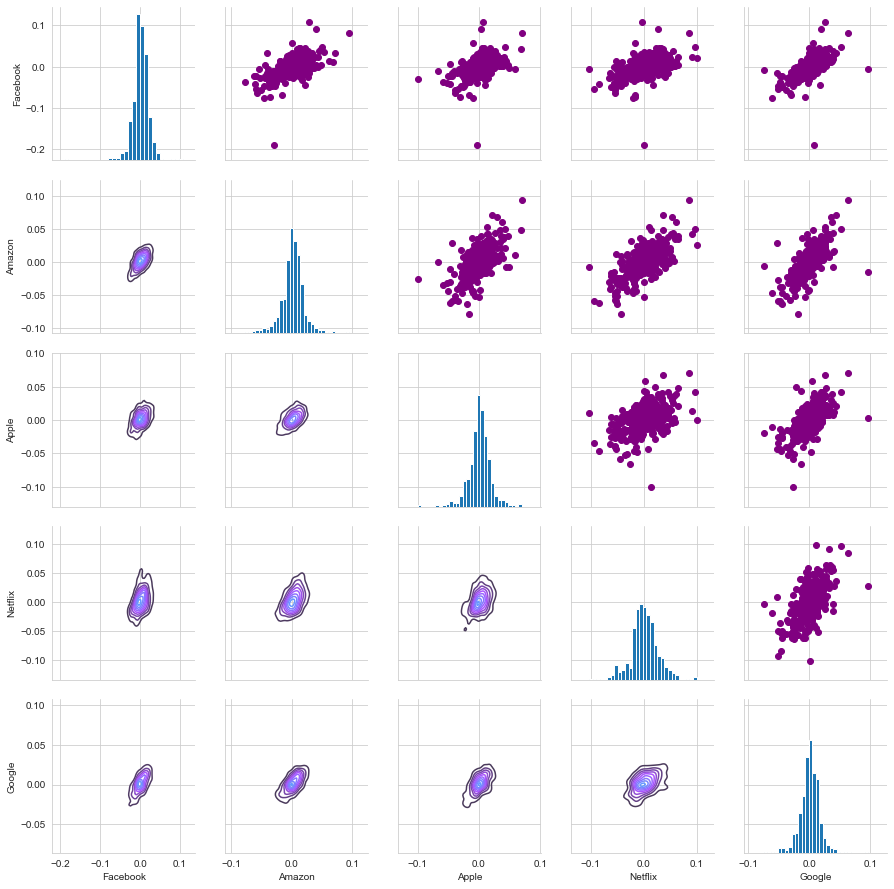

In [25]:
returns_fig = sns.PairGrid(FAANG_portfolio_analysis_pct.dropna())
returns_fig.map_upper(plt.scatter,color='purple')   #upper triangle
returns_fig.map_lower(sns.kdeplot,cmap='cool_d', color="red")    #lower triangle
returns_fig.map_diag(plt.hist,bins=30);

Upon inital inspection, Google seems to have a postiive correlation with the other stocks. In order to further analyse it, a heatmap is used.

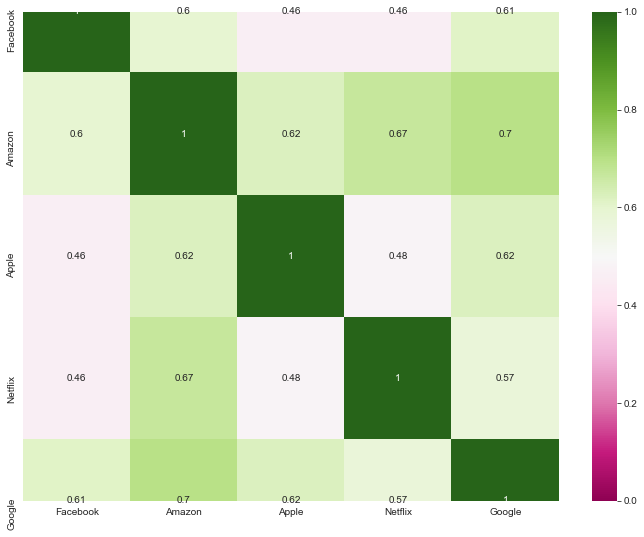

In [26]:
# seaborn correlation plot

FAANG_portfolio_analysis_pct_corr = FAANG_portfolio_analysis_pct.dropna().corr()

fig , ax = plt.subplots(figsize=(12,9))
sns.heatmap(FAANG_portfolio_analysis_pct_corr, vmax=1, vmin=0, cmap="PiYG",annot=True);

By using heatmap as a visualisation tool, it is further suggested that Google's price is highly positively correlated with the price movement of the other stocks. 



###  2b. 2) Price Forecasting

Price Forecasting has long been one of the most important tasks for traders and portfolio managers. By predicting the correct future movement of the stock or portfolio's performance, traders and portfolio managers can then implement their trading strategies based on their view.

In this module, less emphasis is put on this price forecasting and it will be discussed in depth in the future.

###  2b. 3) Risk Analysis



In [27]:
portfolio_risk =FAANG_portfolio_analysis_pct.dropna().copy()

In [28]:
# Display the mean return and the S.D. of the particular stock

for comp in tech_name:
    print(comp)
    print(f"The mean return of {comp} is {portfolio_risk[comp].mean()}")
    print(f"The standard deviation of {comp} is {portfolio_risk[comp].std()}\n")


Facebook
The mean return of Facebook is 0.00042544508242950603
The standard deviation of Facebook is 0.02109432328008627

Amazon
The mean return of Amazon is 0.0010522558828134243
The standard deviation of Amazon is 0.019022484763213356

Apple
The mean return of Apple is 0.001079565153713558
The standard deviation of Apple is 0.017332964638172684

Netflix
The mean return of Netflix is 0.0012308250132759917
The standard deviation of Netflix is 0.02574435228429448

Google
The mean return of Google is 0.0005921528360097783
The standard deviation of Google is 0.016455478535401264



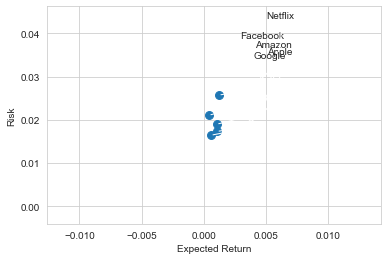

In [29]:
portfolio_risk =FAANG_portfolio_analysis_pct.dropna()

area = np.pi*20

plt.scatter(portfolio_risk.mean(),portfolio_risk.std(),s=area)

plt.xlabel('Expected Return')
plt.ylabel('Risk')


# Documentation for matplotlib annotaion: 

for label, x , y in zip(portfolio_risk.columns,portfolio_risk.mean(),portfolio_risk.std()):
    plt.annotate(
        label,
        xy = (x,y), xytext = (75,75),
        textcoords = 'offset points', ha='right', va='bottom',
        arrowprops = dict(arrowstyle = '-',
                          connectionstyle = 'arc3,rad=-0.5'));



Since this graph is not particularly clear on showing showing the relationship between expected return and risk, a histogram for each stock is plotted instead and VaR (Value at Risk) is subsequently calculated.

### [VaR (Value at Risk)](https://www.investopedia.com/terms/v/var.asp)

#### While calculating the expected return of a stock, one should always also consider the inherent risk from the stock.

#### Questions like: _What is the most I can - with a 95% or 99% level of confidence - expect to lose in dollars over the next month?_ are hence constantly raised by portfolio manager or their investors

In order to answer this question, several approach can be used.
1. Historical Method
2. Variance-Covariance Method
3. Monte Carlo Simulation

In [30]:
portfolio_risk

,Facebook,Amazon,Apple,Netflix,Google
date,,,,,
2017-11-21,0.017456,0.011702,0.018591,0.010974,0.015116
2017-11-22,-0.005444,0.014629,0.010511,0.000459,0.001542
2017-11-24,0.010560,0.025810,0.000058,-0.002903,0.004373
2017-11-27,0.001368,0.008288,-0.005030,-0.003576,0.014661
2017-11-28,-0.003333,-0.001865,-0.005859,0.021174,-0.008134
2017-11-29,-0.039963,-0.027086,-0.020743,-0.055377,-0.024368
2017-11-30,0.011706,0.013330,0.013984,-0.003029,-0.001166
2017-12-01,-0.011739,-0.012237,-0.004655,-0.004052,-0.010713
2017-12-04,-0.020731,-0.024433,-0.007308,-0.014881,-0.012877


In [31]:
portfolio_risk.columns

Index(['Facebook', 'Amazon', 'Apple', 'Netflix', 'Google'], dtype='object')

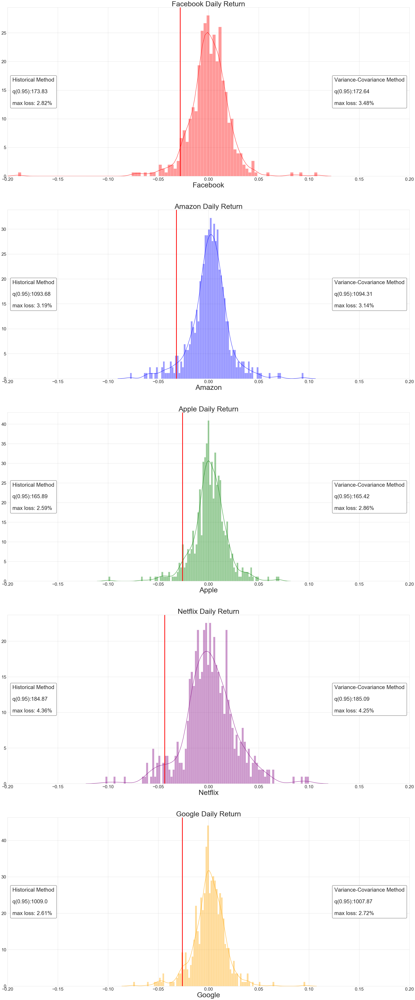

In [32]:
fig, ax = plt.subplots(nrows=5, ncols=1, figsize=(40,100))

colours=["red","blue","green","purple","orange"]


for i in range(len(list(portfolio_risk.columns))):
    sns.distplot(portfolio_risk[portfolio_risk.columns[i]].dropna(),bins=100, color = colours[i], ax=ax[i])
    ax[i].set_xlabel(portfolio_risk.columns[i],fontsize=40)
    ax[i].tick_params(labelsize=25)
    ax[i].set_title(f"{portfolio_risk.columns[i]} Daily Return", fontsize=40)
    ax[i].set_xlim(-.2,.2)
    
    # Plot a line at the 5% quantile result
    ax[i].axvline(x=portfolio_risk[portfolio_risk.columns[i]].quantile(0.05), linewidth=4,color='r')
    
    

    q = np.percentile(FAANG_portfolio[portfolio_risk.columns[i]],5)
    sp = tech_df[i]["open"].iloc[0]
    
    historical = AnchoredText(f"Historical Method\n\nq(0.95):{round(((1+portfolio_risk[portfolio_risk.columns[i]].dropna().quantile(0.05))*sp),2)}\n\nmax loss: {round(100*(-portfolio_risk[portfolio_risk.columns[i]].dropna().quantile(0.05)),2)}%",
                  prop=dict(size=30), frameon=True,
                  loc='center left',
                  )
    historical.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
    ax[i].add_artist(historical)
    
    Variance_Covariance = AnchoredText(f"Variance-Covariance Method\n\nq(0.95):{round(((1-1.65*(portfolio_risk[portfolio_risk.columns[i]].dropna().std()))*sp),2)}\n\nmax loss: {round(1.65*100*(portfolio_risk[portfolio_risk.columns[i]].dropna().std()),2)}%",
                  prop=dict(size=30), frameon=True,
                  loc='center right',
                  )
    Variance_Covariance.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
    ax[i].add_artist(Variance_Covariance)




###  2b. 3.1) Historical Method

The historical method simply re-organizes actual historical returns, putting them in order from worst to best. The corresponding value of the worst 5% column is then identified.

Interpretation of the VaR value: 

for VaR = 4% and CI=0.05,
- With 95% confidence, we expect that our worst daily loss will not exceed 4%.
- If we invest `$100`, we are `95%` confident that our worst daily loss will not exceed `$4` ($100 x -4%). 

In [33]:
# The VaR percentile can also be calculated

quant=0.05

for comp in tech_name:
    print(comp)
    print(f"The VaR of {comp} with the confidence level {quant} is {-portfolio_risk[comp].quantile(quant)}")
    print(f"With {(1-quant)*100}% confidence, it is expected that the worst daily loss for {comp} will not exceed {round(100*-portfolio_risk[comp].quantile(quant),2)}%\n")

Facebook
The VaR of Facebook with the confidence level 0.05 is 0.028186024830499853
With 95.0% confidence, it is expected that the worst daily loss for Facebook will not exceed 2.82%

Amazon
The VaR of Amazon with the confidence level 0.05 is 0.03194207024062072
With 95.0% confidence, it is expected that the worst daily loss for Amazon will not exceed 3.19%

Apple
The VaR of Apple with the confidence level 0.05 is 0.02585025622864314
With 95.0% confidence, it is expected that the worst daily loss for Apple will not exceed 2.59%

Netflix
The VaR of Netflix with the confidence level 0.05 is 0.04361689366551189
With 95.0% confidence, it is expected that the worst daily loss for Netflix will not exceed 4.36%

Google
The VaR of Google with the confidence level 0.05 is 0.02605833106507596
With 95.0% confidence, it is expected that the worst daily loss for Google will not exceed 2.61%



### 2b. 3.2) Variance-Covariance Method

This method assumes that stock returns are normally distributed. Therefore, instead of looking at the actual return of the worst 5%, the value of the worst 5% from the normal curve is obtained instead.

In [34]:
for comp in tech_name:
    print(comp)
    print(f"The VaR of {comp} with the confidence level {quant} using VC method is {1.65*(portfolio_risk[comp].std())}")
    print(f"With {(1-quant)*100}% confidence, it is expected that the worst daily loss for {comp} will not exceed {round(1.65*100*(portfolio_risk[comp].std()),2)}%\n")

Facebook
The VaR of Facebook with the confidence level 0.05 using VC method is 0.034805633412142344
With 95.0% confidence, it is expected that the worst daily loss for Facebook will not exceed 3.48%

Amazon
The VaR of Amazon with the confidence level 0.05 using VC method is 0.031387099859302034
With 95.0% confidence, it is expected that the worst daily loss for Amazon will not exceed 3.14%

Apple
The VaR of Apple with the confidence level 0.05 using VC method is 0.02859939165298493
With 95.0% confidence, it is expected that the worst daily loss for Apple will not exceed 2.86%

Netflix
The VaR of Netflix with the confidence level 0.05 using VC method is 0.04247818126908589
With 95.0% confidence, it is expected that the worst daily loss for Netflix will not exceed 4.25%

Google
The VaR of Google with the confidence level 0.05 using VC method is 0.027151539583412085
With 95.0% confidence, it is expected that the worst daily loss for Google will not exceed 2.72%





### 2b. 3.3) Monte Carlo Simulation
Monte Carlo simulations are used to model the probability of different outcomes in a process that cannot easily be predicted due to the intervention of random variables. It is a technique used to understand the impact of risk and uncertainty in prediction and forecasting models.

For more info please click [here](https://www.investopedia.com/terms/m/montecarlosimulation.asp)

_To demonstrate the importance of the diversification, the price movement of Facebook is firstly computed and then the price movement of FAANG portfolio is calculated._

In [35]:
# Essential inputs for the Monte Carlo Simulation

# Simulate the change of stock price for next year using the mean and sd values from the 5 stocks
days = 365

dt = 1/days





# Monte Carlo function
def stock_monte_carlo(start_price,days,mu,sigma):
    
    
    price = np.zeros(days)
    price[0] = start_price
    
    shock = np.zeros(days)
    drift = np.zeros(days)
    
    for x in range(1,days):
        
        shock[x] = np.random.normal(loc=mu*dt,scale=sigma*np.sqrt(dt))
        
        drift[x] = mu * dt
        
        price[x] = price[x-1] + (price[x-1] * (drift[x] + shock[x]))
        
    return price



In [36]:
for i in range(len(list(portfolio_risk.columns))):
    print(i,portfolio_risk.columns[i])

0 Facebook
1 Amazon
2 Apple
3 Netflix
4 Google


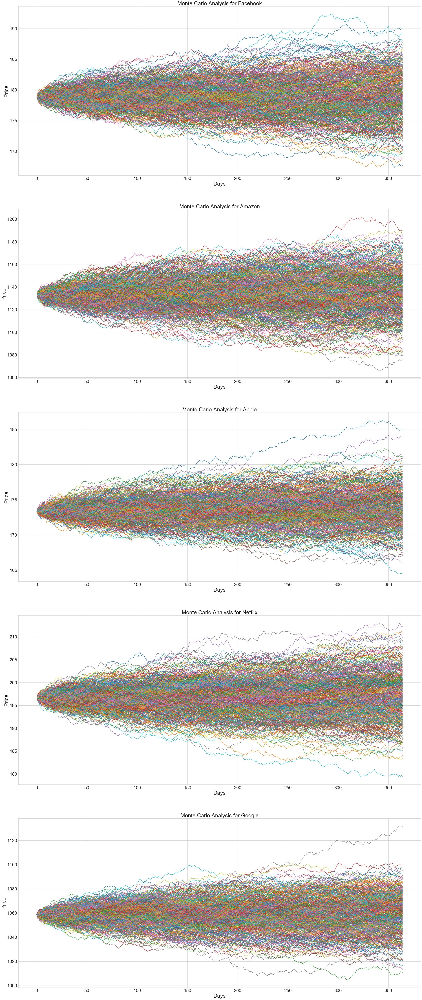

In [37]:
# Plot Monte Carlo Function

fig, ax = plt.subplots(nrows=5, ncols=1, figsize=(40,100))

for i in range(len(list(portfolio_risk.columns))):
    start_price = tech_df[i]["open"].iloc[i]
    mu = portfolio_risk.mean()[portfolio_risk.columns[i]]

    sigma = portfolio_risk.std()[portfolio_risk.columns[i]]


    for run in range(500):   # do simulation for 500 times
        ax[i].plot(stock_monte_carlo(start_price,days,mu,sigma))
    
    ax[i].tick_params(labelsize=25)
    ax[i].set_xlabel("Days", fontsize=30)
    ax[i].set_ylabel("Price", fontsize=30)
    ax[i].set_title(f"Monte Carlo Analysis for {portfolio_risk.columns[i]}", fontsize=30);

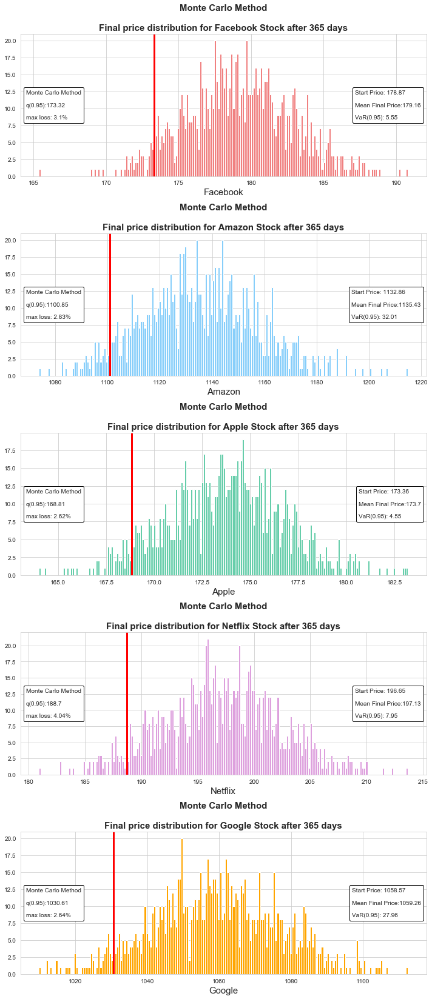

In [38]:
fig, ax = plt.subplots(nrows=5, ncols=1, figsize=(10,23))
colours=["lightcoral","lightskyblue","mediumaquamarine","plum","orange"]

for i in range(len(list(portfolio_risk.columns))):
    start_price = tech_df[i]["open"].iloc[i]
    mu = portfolio_risk.mean()[portfolio_risk.columns[i]]

    sigma = portfolio_risk.std()[portfolio_risk.columns[i]]

    runs = 1000

    simulations = np.zeros(runs)

    for run in range(runs):
        simulations[run] = stock_monte_carlo(start_price,days,mu,sigma)[days-1]
    
    #set the confidence interval as 5
    q = np.percentile(simulations,5)
    
    #Plot the simulations by using histogram graph
    ax[i].hist(simulations,bins=200,color=colours[i])

    #Starting Price & Mean Ending Price 
    right_text_box = AnchoredText(f"Start Price: {start_price}\n\nMean Final Price:{round(simulations.mean(),2)}\n\nVaR(0.95): {round(start_price-q,2)}",
                  prop=dict(size=10), frameon=True,
                  loc='center right',
                  )
    right_text_box.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
    ax[i].add_artist(right_text_box)
    
    left_text_box = AnchoredText(f"Monte Carlo Method\n\nq(0.95):{round(q,2)}\n\nmax loss: {-round(100*((q/start_price)-1),2)}%",
                  prop=dict(size=10), frameon=True,
                  loc='center left',
                  )
    left_text_box.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
    ax[i].add_artist(left_text_box)
    
    # Plot a line at the 5% quantile result & Display 5% quantile
    ax[i].axvline(x=q, linewidth=3,color='r')

    # Title
    ax[i].set_title(f"Monte Carlo Method\n\nFinal price distribution for {portfolio_risk.columns[i]} Stock after {days} days", weight='bold', fontsize=15)
    ax[i].set_xlabel(portfolio_risk.columns[i],fontsize=15)
    ax[i].tick_params(labelsize=10);
    
    plt.tight_layout();


### 2b. 4) Portfolio Management 

- Equal Weight Portfolio
- Market Capitalisation Weighted Portfolio (tbd)

##### Equal Weight Portfolio
Equal Weight Portfolio essentially means one is investing an equal amount of investment to each indvidual stock in his/her portfolio, regardless of the actual trading price and the size of the underlying.

Assuming one decided to invest in FAANG in 19th Novemeber, 2017, they would split their 20% of their invesmtment equally on each of the FAANG stocks.

Below is the performance of the new portfolio.

In [39]:
# Open price of FAANG

for i in range(len(list(portfolio_risk.columns))):
    print(list(portfolio_risk.columns)[i])
    print(tech_df[i]["open"].iloc[0])
    

Facebook
178.87
Amazon
1129.77
Apple
170.29
Netflix
193.3
Google
1036.0


In [40]:
# Construction of the new FAANG portfolio

FAANG_open_price=pd.DataFrame(columns=["Company", "Open Price"])

for i in range(len(list(portfolio_risk.columns))):
    FAANG_open_price = FAANG_open_price.append({"Company": list(portfolio_risk.columns)[i], "Open Price": tech_df[i]["open"].iloc[0]}, ignore_index= True)

FAANG_open_price

,Company,Open Price
0,Facebook,178.87
1,Amazon,1129.77
2,Apple,170.29
3,Netflix,193.30
4,Google,1036.00


In [41]:
# Construction of equally weighted Portfolio based on its price

FAANG_open_price= FAANG_open_price.assign(Equally_Weighted= FAANG_open_price["Open Price"].min()/FAANG_open_price["Open Price"])

FAANG_open_price= FAANG_open_price.assign(Portfolio_Weight_EW= FAANG_open_price["Open Price"]*FAANG_open_price["Equally_Weighted"]/((FAANG_open_price["Open Price"]*FAANG_open_price["Equally_Weighted"]).sum()))

In [42]:
# Portfolio_EW visualisation

fig = go.Figure()

fig.add_trace(go.Pie(labels=FAANG_open_price["Company"],values=FAANG_open_price["Portfolio_Weight_EW"]))

fig.show()

In [43]:
# Get a new DataFrame of FB to be the base of the portfolio construction
Portfolio_EW = web.DataReader("FB", "av-daily-adjusted", start=start,end=end,api_key=password)

Portfolio_EW

,open,high,low,close,adjusted close,volume,dividend amount,split coefficient
2017-11-20,178.8700,179.5000,178.1000,178.740,178.740,10052391,0.0,1.0
2017-11-21,179.1500,181.8900,178.9900,181.860,181.860,14409305,0.0,1.0
2017-11-22,181.3000,181.7300,180.4400,180.870,180.870,10238140,0.0,1.0
2017-11-24,180.4000,183.1500,180.2900,182.780,182.780,9426010,0.0,1.0
2017-11-27,182.5600,183.7300,181.9900,183.030,183.030,12249740,0.0,1.0
2017-11-28,183.5100,184.2500,182.0900,182.420,182.420,13761926,0.0,1.0
2017-11-29,181.8900,181.9700,174.0000,175.130,175.130,41843917,0.0,1.0
2017-11-30,176.8500,178.2750,175.2000,177.180,177.180,25127073,0.0,1.0
2017-12-01,176.0300,177.4800,172.3400,175.100,175.100,19966643,0.0,1.0
2017-12-04,176.2900,176.5700,170.7900,171.470,171.470,24184006,0.0,1.0


In [44]:
# Drop irrelevant columns
Portfolio_EW = Portfolio_EW.drop(["volume","dividend amount","split coefficient"], axis=1)

# Multiply each column to its own equally_weighted index
Portfolio_EW= Portfolio_EW*FAANG_open_price["Equally_Weighted"][0]

In [45]:
# Add all other 4 stocks (Amazon, Apple, Netflix, Google) and their proportional weight into the dataframe
Portfolio_EW= (Portfolio_EW 
               + AMZN.drop(["volume","dividend amount","split coefficient"], axis=1)*FAANG_open_price["Equally_Weighted"][1]
               + AAPL.drop(["volume","dividend amount","split coefficient"], axis=1)*FAANG_open_price["Equally_Weighted"][2]
               + NFLX.drop(["volume","dividend amount","split coefficient"], axis=1)*FAANG_open_price["Equally_Weighted"][3]
               + GOOGL.drop(["volume","dividend amount","split coefficient"], axis=1)*FAANG_open_price["Equally_Weighted"][4]
              )

In [46]:
Portfolio_EW

,open,high,low,close,adjusted close
2017-11-20,851.450000,854.212332,847.119602,850.979221,845.980421
2017-11-21,854.869264,865.360085,853.804935,863.543417,858.451717
2017-11-22,863.907578,869.713150,859.537295,867.279141,862.133841
2017-11-24,868.352717,876.464759,866.225023,873.859265,868.713765
2017-11-27,876.410557,881.808731,870.424082,876.628405,871.508705
2017-11-28,879.240422,885.395517,868.613870,876.896583,871.806883
2017-11-29,874.726333,875.623055,837.053050,847.517267,842.533167
2017-11-30,853.307189,859.277600,843.855904,853.471191,848.417391
2017-12-01,848.301370,856.145532,836.342450,846.026388,840.996088
2017-12-04,853.009080,854.518159,825.284934,832.420991,827.427491


In [47]:
Portfolio_EW = Portfolio_EW.reset_index().rename(columns={"index":"date"})

#Convert object to datetime format
Portfolio_EW["date"] = pd.to_datetime(Portfolio_EW["date"])

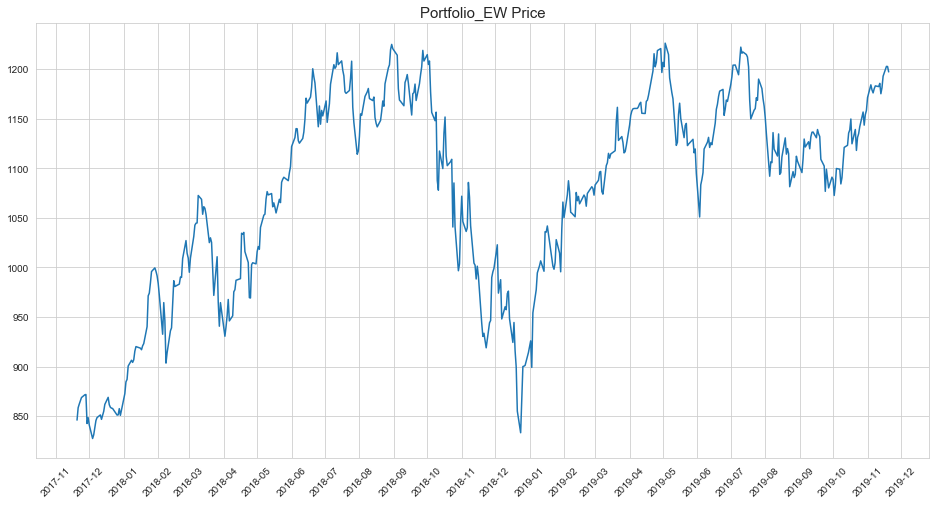

In [48]:
# Simple price performance
fig, ax = plt.subplots(figsize=(16,8))

ax.plot("date","adjusted close",data=Portfolio_EW);

ax.xaxis.set_major_locator(months);
plt.xticks(rotation=45);
plt.title("Portfolio_EW Price", fontsize=15);

In [49]:
# Add simple moving average (SMA) to Porfolio_EW

ma_day = [10,20,50]

for ma in ma_day:
    column_name = f"MA for {ma} days"
    
    Portfolio_EW[column_name] = Portfolio_EW['adjusted close'].rolling(ma).mean()

In [50]:
# Candlestick graph
fig = go.Figure()
# Plot the candlestick graph and the other trendlines (MAs)
fig.add_trace(go.Candlestick(x=Portfolio_EW["date"],
                open=Portfolio_EW["open"], high=Portfolio_EW["high"],
                low=Portfolio_EW["low"], close=Portfolio_EW["close"],name="Adjusted Price"))
fig.add_trace(go.Scatter(x=Portfolio_EW["date"], y=Portfolio_EW["adjusted close"],name="price",line = dict(width = 1, color="lightblue"),mode="lines"))
fig.add_trace(go.Scatter(x=Portfolio_EW["date"], y=Portfolio_EW["MA for 20 days"], name="MA for 20 days",line = dict(color='royalblue',width = 1.5),mode="lines"))
fig.add_trace(go.Scatter(x=Portfolio_EW["date"], y=Portfolio_EW["MA for 50 days"],name="MA for 50 days",line = dict(color='burlywood',width = 1.5),mode="lines"))

# Manually enlarging the graph and adding title for the graph
fig.update_layout(autosize= False, width =1000, height=500,title=f"Portfolio_EW Candlestick Graph from {Portfolio_EW['date'].iloc[0].strftime('%b %Y')} to {Portfolio_EW['date'].iloc[-1].strftime('%b %Y')} ", showlegend=True) 

# Add monthly ticks in x-axis
fig.layout.xaxis.tickvals = pd.date_range(Portfolio_EW["date"].iloc[0], Portfolio_EW["date"].iloc[-1], freq='MS')
fig.layout.xaxis.tickformat = '%b %y'

# Not showing rangeslider
fig.layout.xaxis.rangeslider.visible=False

#Rotate the x-axis and change the fontsize of the x-axis 
fig.update_xaxes(tickangle=-45, tickfont=dict(size=10))

fig.show()

In [51]:
# Calcualte the daily return of the portfolio based on the new adjusted close
Portfolio_EW["Daily Return"] = Portfolio_EW["adjusted close"].pct_change()

In [52]:
Portfolio_EW

,date,open,high,low,close,adjusted close,MA for 10 days,MA for 20 days,MA for 50 days,Daily Return
0,2017-11-20,851.450000,854.212332,847.119602,850.979221,845.980421,NaN,NaN,NaN,NaN
1,2017-11-21,854.869264,865.360085,853.804935,863.543417,858.451717,NaN,NaN,NaN,0.014742
2,2017-11-22,863.907578,869.713150,859.537295,867.279141,862.133841,NaN,NaN,NaN,0.004289
3,2017-11-24,868.352717,876.464759,866.225023,873.859265,868.713765,NaN,NaN,NaN,0.007632
4,2017-11-27,876.410557,881.808731,870.424082,876.628405,871.508705,NaN,NaN,NaN,0.003217
5,2017-11-28,879.240422,885.395517,868.613870,876.896583,871.806883,NaN,NaN,NaN,0.000342
6,2017-11-29,874.726333,875.623055,837.053050,847.517267,842.533167,NaN,NaN,NaN,-0.033578
7,2017-11-30,853.307189,859.277600,843.855904,853.471191,848.417391,NaN,NaN,NaN,0.006984
8,2017-12-01,848.301370,856.145532,836.342450,846.026388,840.996088,NaN,NaN,NaN,-0.008747
9,2017-12-04,853.009080,854.518159,825.284934,832.420991,827.427491,853.796947,NaN,NaN,-0.016134


In [53]:
# Quick Summary 

print(f"The mean return of Portfolio_EW is {Portfolio_EW['Daily Return'].dropna().mean()}")
print(f"The standard deviation of Portfolio_EW is {Portfolio_EW['Daily Return'].dropna().std()}\n")

The mean return of Portfolio_EW is 0.0008305446002236013
The standard deviation of Portfolio_EW is 0.016733145849255494



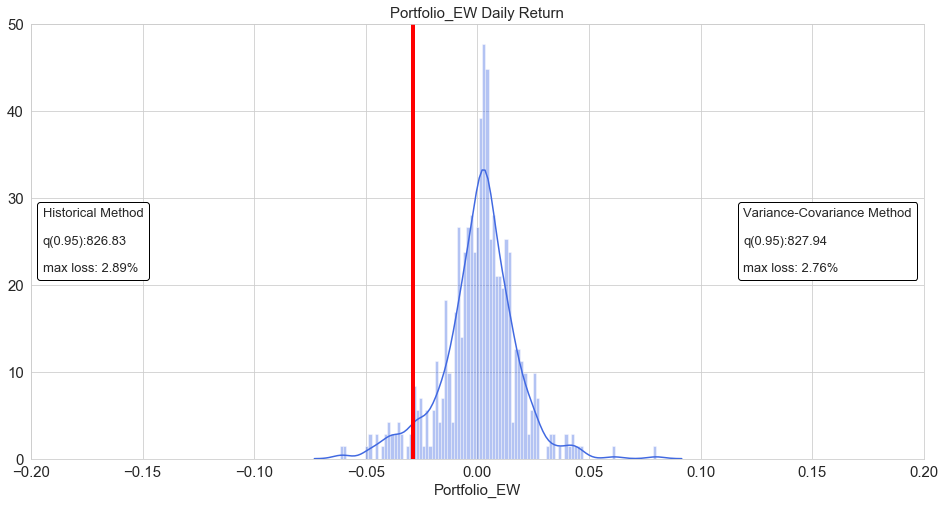

In [54]:
fig, ax = plt.subplots(figsize=(16,8))

sns.distplot(Portfolio_EW["Daily Return"].dropna(),bins=100, color = "royalblue", ax=ax)
ax.set_xlabel("Portfolio_EW",fontsize=15)
ax.tick_params(labelsize=15)
ax.set_title(f"Portfolio_EW Daily Return", fontsize=15)
ax.set_xlim(-.2,.2)
    
# Plot a line at the 5% quantile result
ax.axvline(x=Portfolio_EW["Daily Return"].dropna().quantile(0.05), linewidth=4,color='r')
    
q = np.percentile(Portfolio_EW["Daily Return"].dropna(),5)
sp = Portfolio_EW["open"].iloc[0]
    
historical = AnchoredText(f"Historical Method\n\nq(0.95):{round(((1+Portfolio_EW['Daily Return'].dropna().quantile(0.05))*sp),2)}\n\nmax loss: {round(100*(-Portfolio_EW['Daily Return'].dropna().quantile(0.05)),2)}%",
                  prop=dict(size=13), frameon=True,
                  loc='center left',
                  )
historical.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
ax.add_artist(historical)
    
Variance_Covariance = AnchoredText(f"Variance-Covariance Method\n\nq(0.95):{round(((1-1.65*(Portfolio_EW['Daily Return'].dropna().std()))*sp),2)}\n\nmax loss: {round(1.65*100*(Portfolio_EW['Daily Return'].dropna().std()),2)}%",
                  prop=dict(size=13), frameon=True,
                  loc='center right',
                  )
Variance_Covariance.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
ax.add_artist(Variance_Covariance);

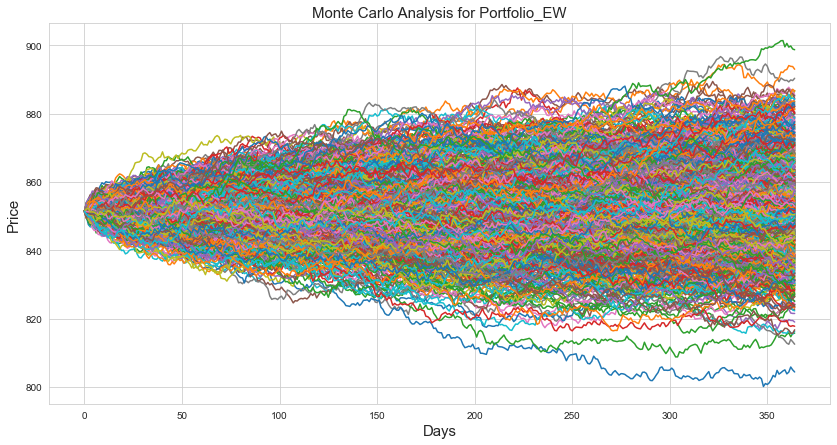

In [55]:
# Plot Monte Carlo Function

fig, ax = plt.subplots(figsize=(14,7))


start_price = Portfolio_EW["open"].iloc[0]
mu = Portfolio_EW["Daily Return"].dropna().mean()

sigma = Portfolio_EW["Daily Return"].dropna().std()


for run in range(1000):   # do simulation for 1000 times
    ax.plot(stock_monte_carlo(start_price,days,mu,sigma))
    
ax.tick_params(labelsize=10)
ax.set_xlabel("Days", fontsize=15)
ax.set_ylabel("Price", fontsize=15)
ax.set_title(f"Monte Carlo Analysis for Portfolio_EW", fontsize=15);

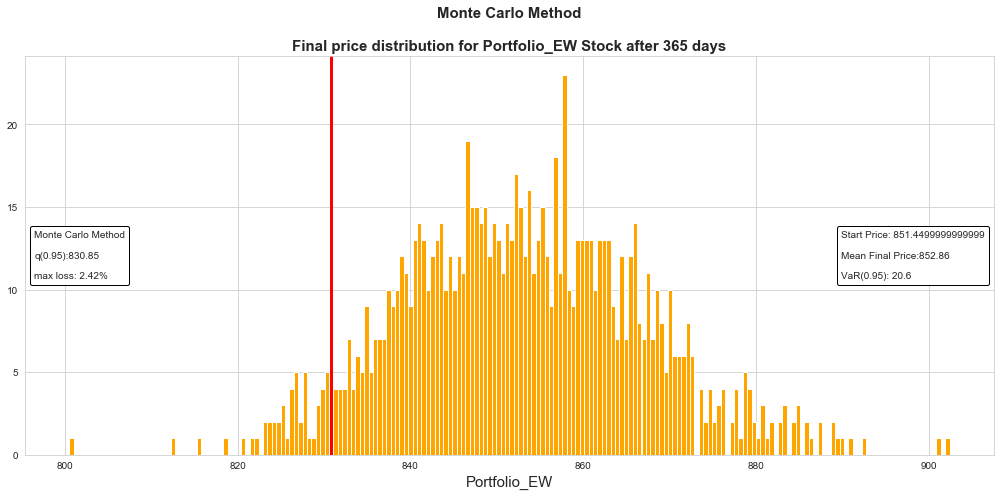

In [56]:
fig, ax = plt.subplots(figsize=(14,7))

start_price = Portfolio_EW["open"].iloc[0]
mu = Portfolio_EW["Daily Return"].dropna().mean()

sigma = Portfolio_EW["Daily Return"].dropna().std()

runs = 1000

simulations = np.zeros(runs)

for run in range(runs):
    simulations[run] = stock_monte_carlo(start_price,days,mu,sigma)[days-1]
    
#set the confidence interval as 5
q = np.percentile(simulations,5)
    
#Plot the simulations by using histogram graph
ax.hist(simulations,bins=200,color=colours[i])

#Starting Price & Mean Ending Price 
right_text_box = AnchoredText(f"Start Price: {start_price}\n\nMean Final Price:{round(simulations.mean(),2)}\n\nVaR(0.95): {round(start_price-q,2)}",
                  prop=dict(size=10), frameon=True,
                  loc='center right',
                  )
right_text_box.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
ax.add_artist(right_text_box)
    
left_text_box = AnchoredText(f"Monte Carlo Method\n\nq(0.95):{round(q,2)}\n\nmax loss: {-round(100*((q/start_price)-1),2)}%",
                  prop=dict(size=10), frameon=True,
                  loc='center left',
                  )
left_text_box.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
ax.add_artist(left_text_box)
    
# Plot a line at the 5% quantile result & Display 5% quantile
ax.axvline(x=q, linewidth=3,color='r')

# Title
ax.set_title(f"Monte Carlo Method\n\nFinal price distribution for Portfolio_EW Stock after {days} days", weight='bold', fontsize=15)
ax.set_xlabel("Portfolio_EW",fontsize=15)
ax.tick_params(labelsize=10);
    
plt.tight_layout();


### Conclusion

By simply diversifying the investment, there is no significant gain in average daily return. However, the main advantage of diversifying the investment is to mitigate [Idiosyncratic Risk](https://www.investopedia.com/terms/i/idiosyncraticrisk.asp) from indiviudal stock investment.

However, there are numerous ways to optimise the portfolio and one of the first elementary steps to create one's optimised portfolio is to create an equal investment portfolio.  

## 3. Hypothesis 

### Null hypothesis: FAANG did not outperform S&P 500 in the last two years.


$$ H_0: mean_{FAANG} = mean_{S\&P500}$$
$$ H_1: mean_{FAANG} \neq mean_{S\&P500}$$

In [57]:
# import S&P 500 historical data

SP500 = pd.read_csv("S&P500.csv")

In [58]:
SP500

,Date,Open,High,Low,Close,Adj Close,Volume
0,2017-11-20,2579.489990,2584.639893,2578.239990,2582.139893,2582.139893,3003540000
1,2017-11-21,2589.169922,2601.189941,2589.169922,2599.030029,2599.030029,3332720000
2,2017-11-22,2600.310059,2600.939941,2595.229980,2597.080078,2597.080078,2762950000
3,2017-11-24,2600.419922,2604.209961,2600.419922,2602.419922,2602.419922,1349780000
4,2017-11-27,2602.659912,2606.409912,2598.870117,2601.419922,2601.419922,3006860000
5,2017-11-28,2605.939941,2627.689941,2605.439941,2627.040039,2627.040039,3488420000
6,2017-11-29,2627.820068,2634.889893,2620.320068,2626.070068,2626.070068,4078280000
7,2017-11-30,2633.929932,2657.739990,2633.929932,2647.580078,2647.580078,4938490000
8,2017-12-01,2645.100098,2650.620117,2605.520020,2642.219971,2642.219971,3942320000
9,2017-12-04,2657.189941,2665.189941,2639.030029,2639.439941,2639.439941,4023150000


In [59]:
SP500["Daily Return"] = SP500["Adj Close"].pct_change()

In [60]:
SP500

,Date,Open,High,Low,Close,Adj Close,Volume,Daily Return
0,2017-11-20,2579.489990,2584.639893,2578.239990,2582.139893,2582.139893,3003540000,NaN
1,2017-11-21,2589.169922,2601.189941,2589.169922,2599.030029,2599.030029,3332720000,0.006541
2,2017-11-22,2600.310059,2600.939941,2595.229980,2597.080078,2597.080078,2762950000,-0.000750
3,2017-11-24,2600.419922,2604.209961,2600.419922,2602.419922,2602.419922,1349780000,0.002056
4,2017-11-27,2602.659912,2606.409912,2598.870117,2601.419922,2601.419922,3006860000,-0.000384
5,2017-11-28,2605.939941,2627.689941,2605.439941,2627.040039,2627.040039,3488420000,0.009849
6,2017-11-29,2627.820068,2634.889893,2620.320068,2626.070068,2626.070068,4078280000,-0.000369
7,2017-11-30,2633.929932,2657.739990,2633.929932,2647.580078,2647.580078,4938490000,0.008191
8,2017-12-01,2645.100098,2650.620117,2605.520020,2642.219971,2642.219971,3942320000,-0.002025
9,2017-12-04,2657.189941,2665.189941,2639.030029,2639.439941,2639.439941,4023150000,-0.001052


In [61]:
# import scipy
import scipy.stats as ss

In [62]:
# Testing null hypothesis (S&P500 vs. Portfolio_EW)

ss.ttest_ind(SP500["Daily Return"].dropna(), Portfolio_EW["Daily Return"].dropna(), equal_var=False)

Ttest_indResult(statistic=-0.48772604050632157, pvalue=0.6258791755979263)

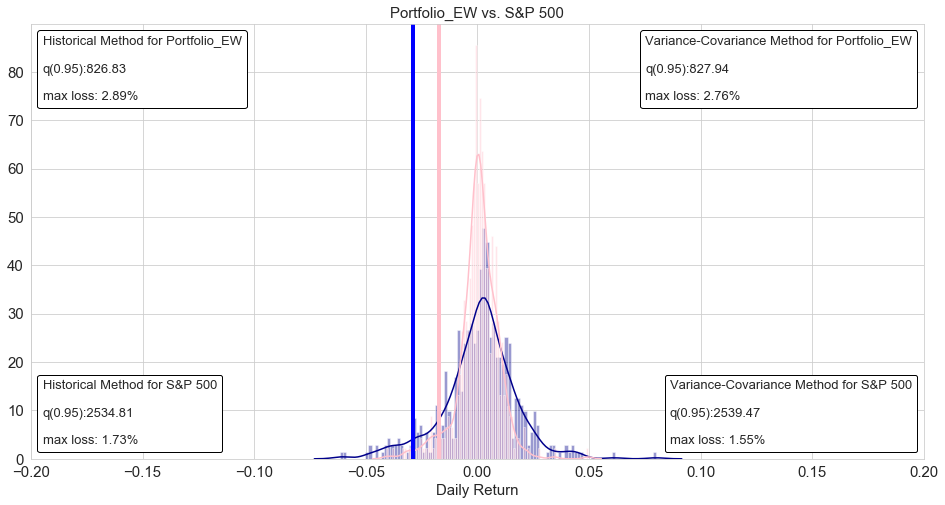

In [63]:
# pink represents S&P500, darkblue represents Portfolio_EW

fig, ax = plt.subplots(figsize=(16,8))

sns.distplot(Portfolio_EW["Daily Return"].dropna(),bins=100, color = "darkblue", ax=ax)
sns.distplot(SP500["Daily Return"].dropna(),bins=100, color = "pink", ax=ax)
ax.set_xlabel("Daily Return",fontsize=15)
ax.tick_params(labelsize=15)
ax.set_title(f"Portfolio_EW vs. S&P 500", fontsize=15)
ax.set_xlim(-.2,.2)
    
# Plot a line at the 5% quantile result for both S&P500 and Portfolio_EW
ax.axvline(x=Portfolio_EW["Daily Return"].dropna().quantile(0.05), linewidth=4,color='b')
ax.axvline(x=SP500["Daily Return"].dropna().quantile(0.05), linewidth=4,color='pink')

#Portfolio EW
q_ew = np.percentile(Portfolio_EW["Daily Return"].dropna(),5)
sp_ew = Portfolio_EW["open"].iloc[0]

#S&P 500
q_sp = np.percentile(SP500["Daily Return"].dropna(),5)
sp_sp = SP500["Open"].iloc[0]


# Historical Method
historical_EW = AnchoredText(f"Historical Method for Portfolio_EW\n\nq(0.95):{round(((1+Portfolio_EW['Daily Return'].dropna().quantile(0.05))*sp_ew),2)}\n\nmax loss: {round(100*(-Portfolio_EW['Daily Return'].dropna().quantile(0.05)),2)}%",
                  prop=dict(size=13), frameon=True,
                  loc='upper left',
                  )
historical_EW.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
ax.add_artist(historical_EW)

historical_SP = AnchoredText(f"Historical Method for S&P 500\n\nq(0.95):{round(((1+SP500['Daily Return'].dropna().quantile(0.05))*sp_sp),2)}\n\nmax loss: {round(100*(-SP500['Daily Return'].dropna().quantile(0.05)),2)}%",
                  prop=dict(size=13), frameon=True,
                  loc='lower left',
                  )
historical_SP.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
ax.add_artist(historical_SP)

# Variance-Covariance Method
Variance_Covariance_EW = AnchoredText(f"Variance-Covariance Method for Portfolio_EW\n\nq(0.95):{round(((1-1.65*(Portfolio_EW['Daily Return'].dropna().std()))*sp_ew),2)}\n\nmax loss: {round(1.65*100*(Portfolio_EW['Daily Return'].dropna().std()),2)}%",
                  prop=dict(size=13), frameon=True,
                  loc='upper right',
                  )
Variance_Covariance_EW.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
ax.add_artist(Variance_Covariance_EW);

Variance_Covariance_SP = AnchoredText(f"Variance-Covariance Method for S&P 500\n\nq(0.95):{round(((1-1.65*(SP500['Daily Return'].dropna().std()))*sp_sp),2)}\n\nmax loss: {round(1.65*100*(SP500['Daily Return'].dropna().std()),2)}%",
                  prop=dict(size=13), frameon=True,
                  loc='lower right',
                  )
Variance_Covariance_SP.patch.set_boxstyle("round,pad=0.,rounding_size=0.2")
ax.add_artist(Variance_Covariance_SP);

## 4. Findings

### Daily Return

According to the above statistical analysis, it is found that while FAANG did have a higher daily return in comparison to S&P500 from the last two years. There is __not enough statistical evidence to reject the null hypothesis__. 

### VaR

As seen from the above graph, the maximum potential loss with a 95% confidence interval of FAANG is significantly higher than that of S&P500.

### Conclusion

While there is __not enough statistical evidence to reject the null hypothesis__, it is seen that 
- FAANG stocks generate a higher return than S&P500
- FAANG stocks have a higher variance than S&P500
- The reason behind the higher variance could potentially be contributed to the fact that S&P 500 has a more diversified portfolio to mitigate the idiosyncratic risk from individual stocks.

Based on the above findings, it is therefore __inconclusive__ whether FAANG outperformed S&P 500 for the last two months.
Moreover, more resources should be allocated to pursuit of the optimisation of a portfolio. 